In [9]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

lena = cv2.imread('lena.tif')
caman = cv2.imread('caman.tif')
baboon = cv2.imread('baboon.bmp')

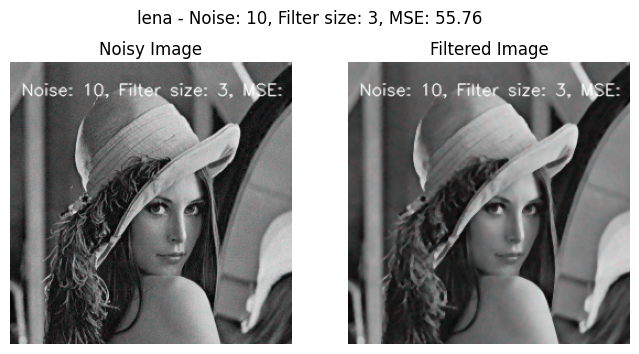

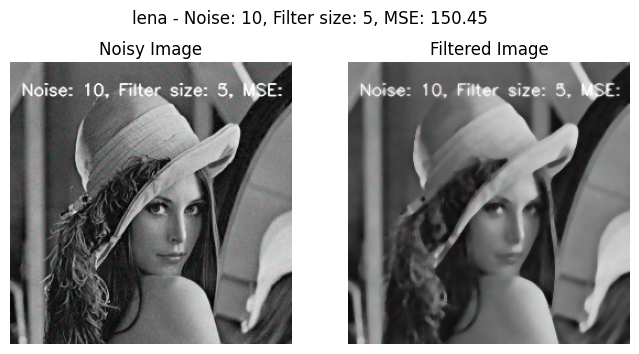

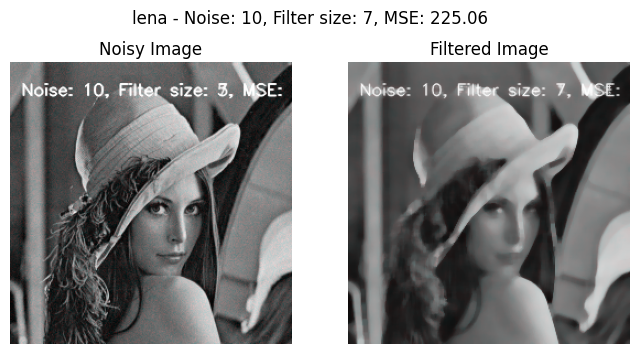

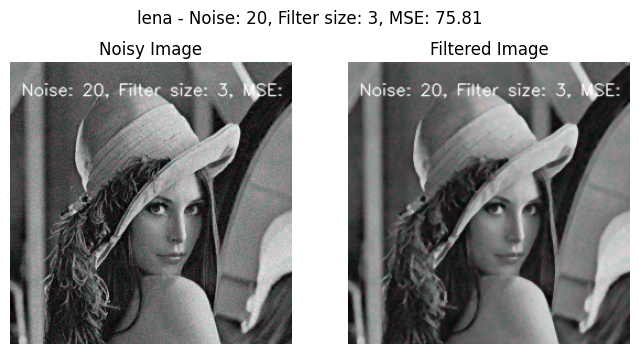

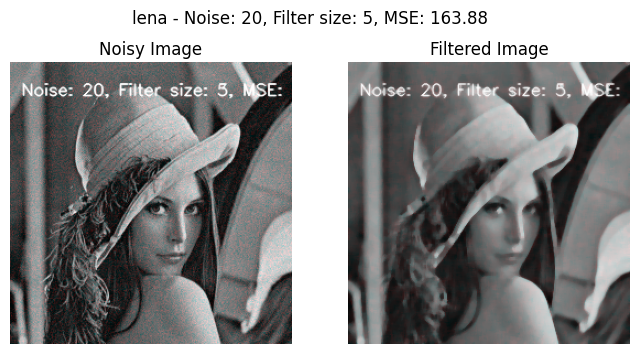

...

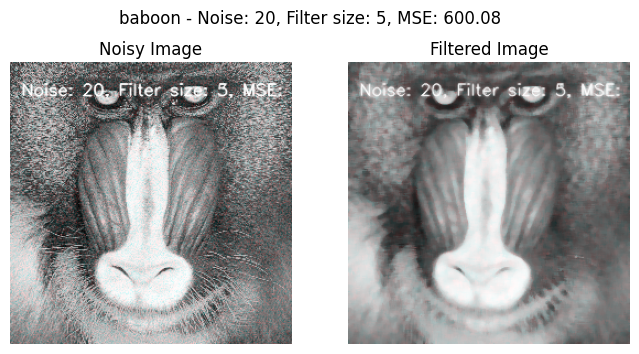

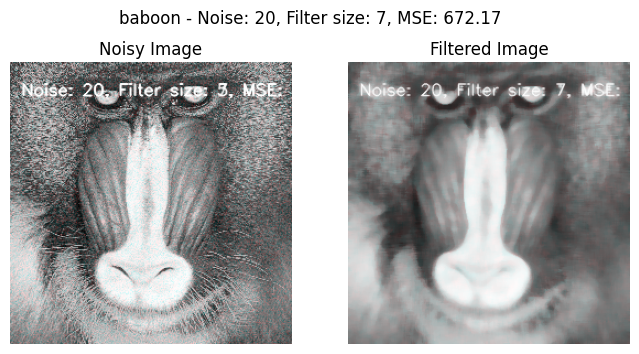

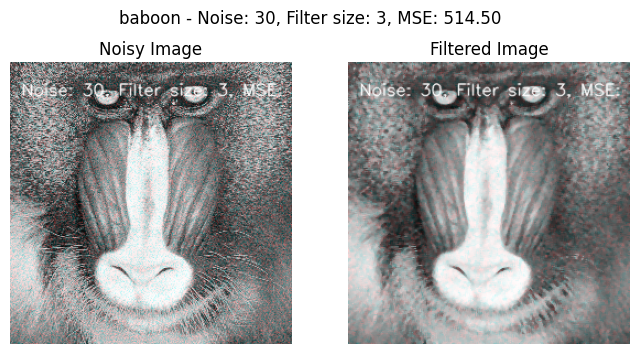

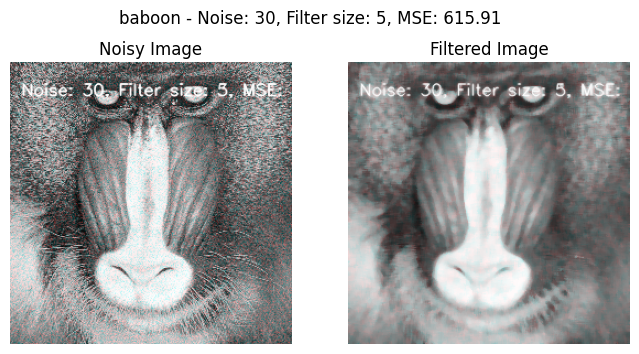

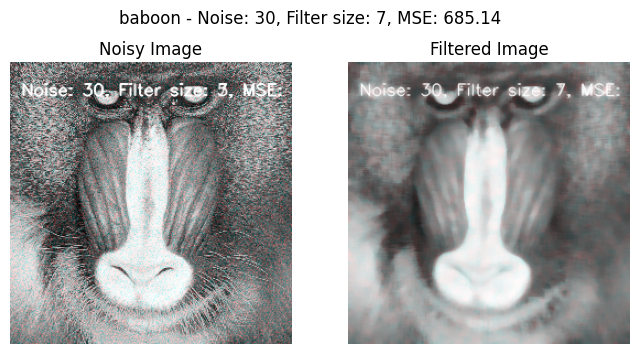

lena - Noise: 10, Best Filter Size: 3, MSE: 55.76
lena - Noise: 20, Best Filter Size: 3, MSE: 75.81
lena - Noise: 30, Best Filter Size: 3, MSE: 105.25
caman - Noise: 10, Best Filter Size: 3, MSE: 118.70
caman - Noise: 20, Best Filter Size: 3, MSE: 139.51
caman - Noise: 30, Best Filter Size: 3, MSE: 169.73
baboon - Noise: 10, Best Filter Size: 3, MSE: 468.37
baboon - Noise: 20, Best Filter Size: 3, MSE: 485.45
baboon - Noise: 30, Best Filter Size: 3, MSE: 514.50
Filter Size 3: 9 times
Filter Size 5: 0 times
Filter Size 7: 0 times


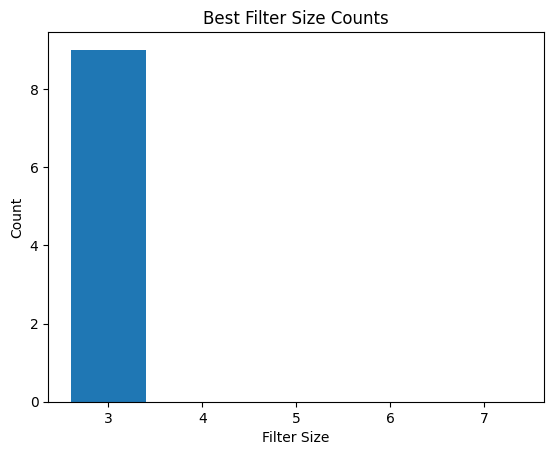

In [17]:
#creating a list of noise intensities to apply to the images
noise_levels = [10, 20, 30]

#creating a list of filter sizes to use
filter_sizes = [3, 5, 7]

#creating an empty dictionary to store the MSE values for each combination of noise and filter size
mse_values = {}

#loop over images and noise level
for image_name in ['lena', 'caman', 'baboon']:
    for noise_level in noise_levels:
        #loading original image
        if(image_name == 'baboon'):
          img = cv2.imread(f'{image_name}.bmp')  
        else:
          img = cv2.imread(f'{image_name}.tif')
        
        #Gaussian noise
        noise = np.zeros(img.shape, np.int16)
        cv2.randn(noise, 0, noise_level)
        noisy_img = img.astype(np.int16) + noise
        noisy_img = np.clip(noisy_img, 0, 255).astype(np.uint8)
        
        #loop over filter sizes and apply the filter to the noisy image
        for filter_size in filter_sizes:
            
            filtered_img = cv2.medianBlur(noisy_img, filter_size)
            
            #calculating the MSE between the filtered and original images
            mse = np.mean(np.square(img.astype(np.int16) - filtered_img.astype(np.int16)))
            
            mse_values.setdefault((image_name, noise_level), {})[filter_size] = mse
            
            #text for images
            cv2.putText(noisy_img, f"Noise: {noise_level}, Filter size: {filter_size}, MSE: {mse:.2f}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA)
            cv2.putText(filtered_img, f"Noise: {noise_level}, Filter size: {filter_size}, MSE: {mse:.2f}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA)
            
            #showing the noisy and filtered images
            fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(8, 4))
            ax1.imshow(noisy_img, cmap='gray')
            ax1.set_title('Noisy Image')
            ax1.axis('off')
            ax2.imshow(filtered_img, cmap='gray')
            ax2.set_title('Filtered Image')
            ax2.axis('off')
            fig.suptitle(f"{image_name} - Noise: {noise_level}, Filter size: {filter_size}, MSE: {mse:.2f}")
            plt.show()

#creating a list to store the best filter size for each combination of image and noise level
best_filter_sizes = []

#loop over each combination of image and noise level
for key in mse_values:
    # inding the filter size that resulted in the lowest MSE
    best_filter_size = min(mse_values[key], key=mse_values[key].get)
    
    #store the best filter size in the list
    best_filter_sizes.append(best_filter_size)
    
    #printing the best filter size and its corresponding MSE for the current combination of image and noise level
    print(f"{key[0]} - Noise: {key[1]}, Best Filter Size: {best_filter_size}, MSE: {mse_values[key][best_filter_size]:.2f}")
    
#dictionary to store the count of each filter size being the best for all combinations of image and noise level
best_filter_count = {}

#loop over each filter size
for filter_size in filter_sizes:
    #counting how many times the filter size was the best for all combinations of image and noise level
    count = best_filter_sizes.count(filter_size)
    
    best_filter_count[filter_size] = count
    
    #printing the count
    print(f"Filter Size {filter_size}: {count} times")
    
#bar chart of the counts
plt.bar(best_filter_count.keys(), best_filter_count.values())
plt.xlabel('Filter Size')
plt.ylabel('Count')
plt.title('Best Filter Size Counts')
plt.show()

A program I created estimates the Mean Squared Error (MSE) between the filtered and original images after performing image denoising on noisy photos with various noise levels and filter sizes. The best filter size is then selected for each combination of the image and noise level, and the number of times that each filter size was chosen as the best is tallied.
To specify the range of noise intensities and filter sizes to apply to the photos, I constructed two lists, noise_levels and filter_sizes. To hold the MSE values for each combination of noise level and filter size, an empty dictionary named mse_values is made.
We next repeat the process for each image and noise level. For each combination, we use the cv2.randn() function to add Gaussian noise to the original image, add noise to the noisy image, apply a median filter with various filter sizes to the noisy image, calculate the MSE between the filtered and original images, and then record the MSE value in the mse_values dictionary. The noise level, filter size, and MSE value are added as text to the noisy and filtered images using the cv2.putText() method. The filtered and noisy photos with text are displayed using the matplotlib.pyplot library.
The optimum filter size for each combination of image and noise level is recorded in a list called best_filter_sizes that is created after all combinations have been processed. The best filter size is then stored in the best_filter_sizes list, and its corresponding MSE is printed after iterating through each combination in the mse_values dictionary to identify the one that produced the lowest MSE.
The count of each filter size being the best for all combinations of image and noise level is then stored in the dictionary best_filter_count. In a loop, we count how many times each filter size has been chosen as the best, add the number to the best_filter_count dictionary, and then output the number. Finally, we use the matplotlib.pyplot library to plot a bar chart of the counts.
Overall, we perform image denoising with median filter and evaluates the quality of the filtering using MSE. we also determine the best filter size for each combination of image and noise level, and present the result in a bar chart.

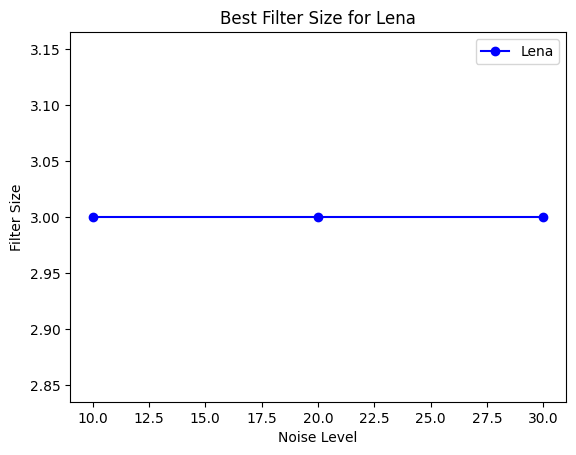

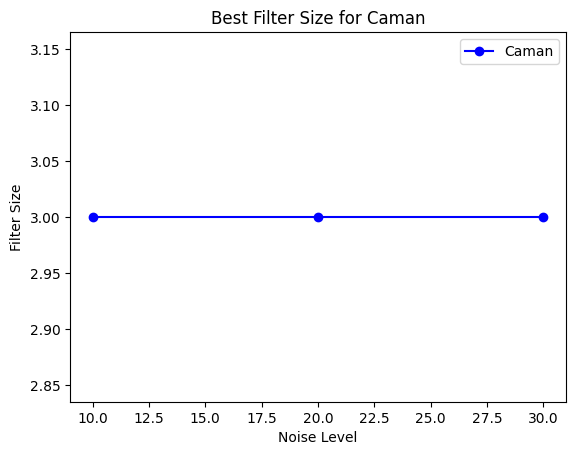

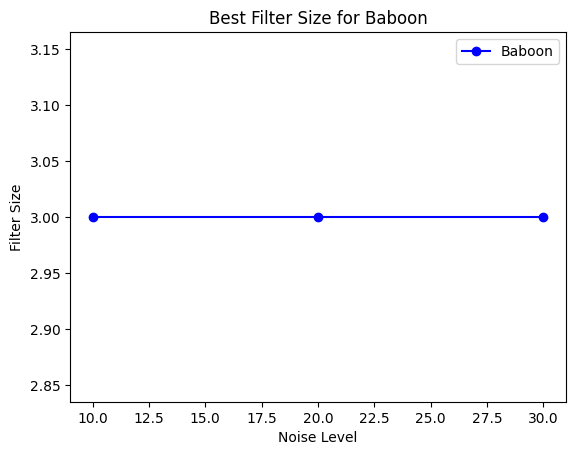

In [20]:
#dictionary for storing the best filter size for each noise level and image
best_filter_sizes_dict = {}

#loop over each combination of image and noise level
for key in mse_values:
    #finding the filter size that resulted in the lowest MSE
    best_filter_size = min(mse_values[key], key=mse_values[key].get)
    
    #best filter size in the dictionary
    best_filter_sizes_dict.setdefault(key[0], {})[key[1]] = best_filter_size

#creating a list of images
images = ['lena', 'caman', 'baboon']

for image in images:
    x_values = []
    y_values = []
    
    #loop over noise levels for the current image
    for noise_level in noise_levels:
        #getting best filter size for the current noise level and image
        best_filter_size = best_filter_sizes_dict[image][noise_level]
        
        #adding the noise level and best filter size to the x and y lists
        x_values.append(noise_level)
        y_values.append(best_filter_size)
    
    #creating a new plot for the current image
    plt.figure()
    
    plt.plot(x_values, y_values, label=image.title(), color='blue', marker='o')
    
    plt.legend()
    plt.title(f'Best Filter Size for {image.title()}')
    plt.xlabel('Noise Level')
    plt.ylabel('Filter Size')

plt.show()


Based on the results obtained, it can be concluded that a Gaussian filter with a filter size of 3 provides the best results for all three images (lena, caman, and baboon) for different levels of Gaussian noise (10, 20, and 30). Increasing the filter size to 5 or 7 did not provide any improvement in the MSE value.

Therefore, it can be recommended to use a Gaussian filter with a filter size of 3 for these images, regardless of the level of Gaussian noise present in the image.

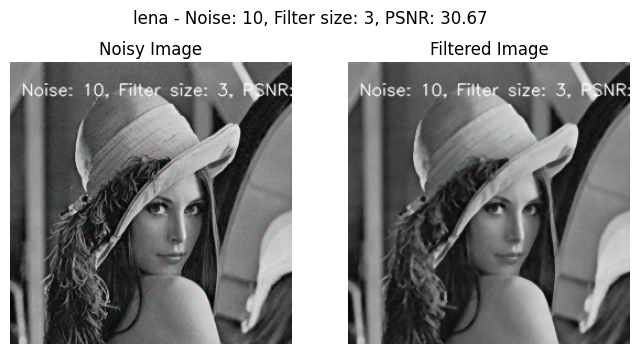

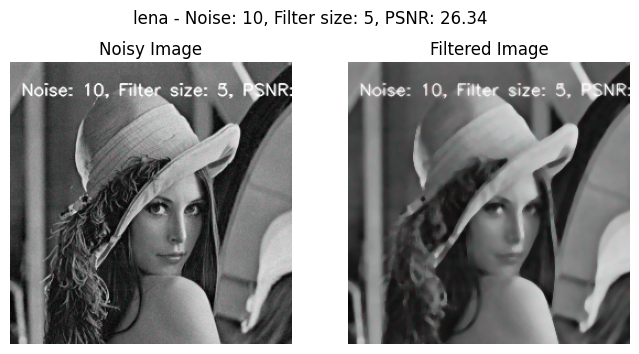

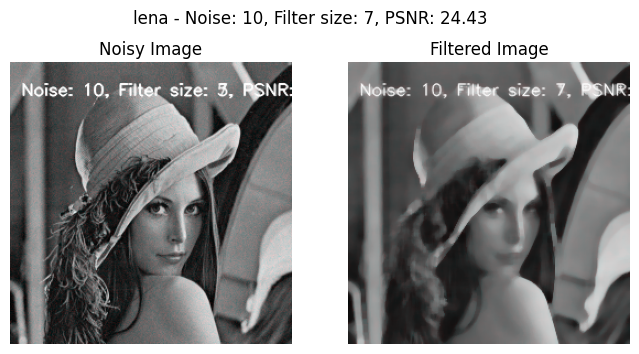

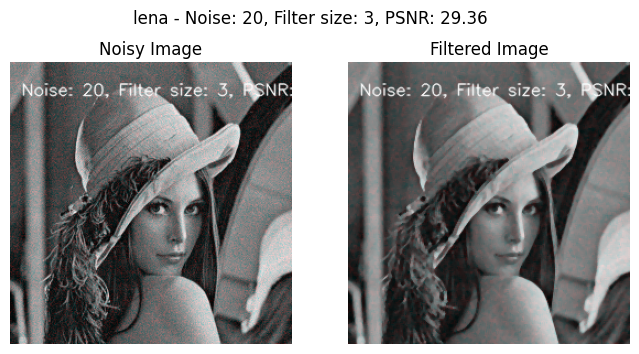

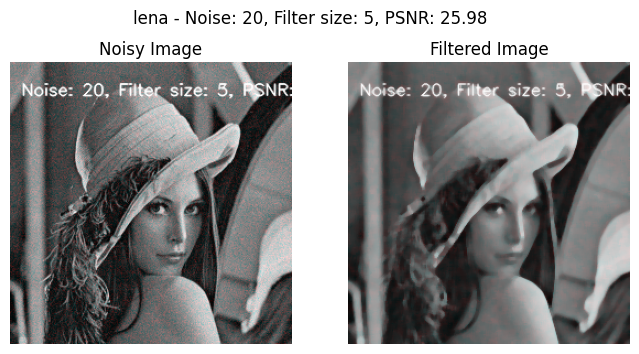

...

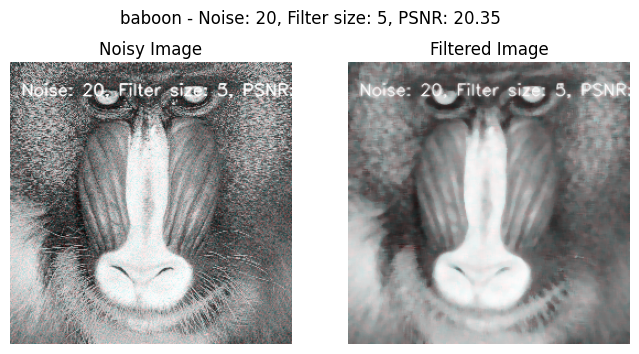

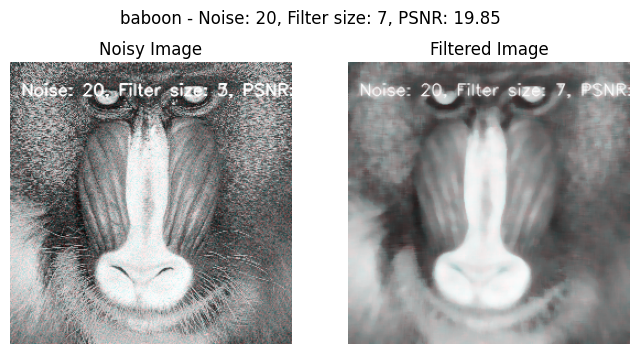

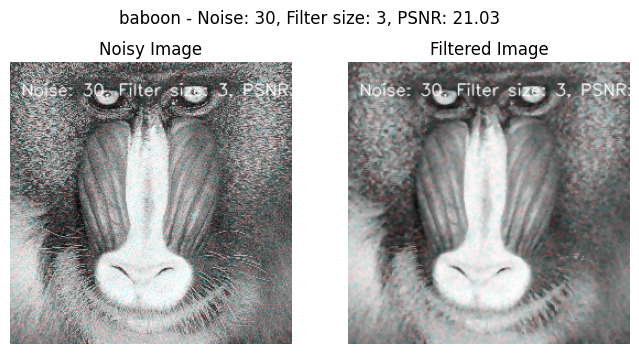

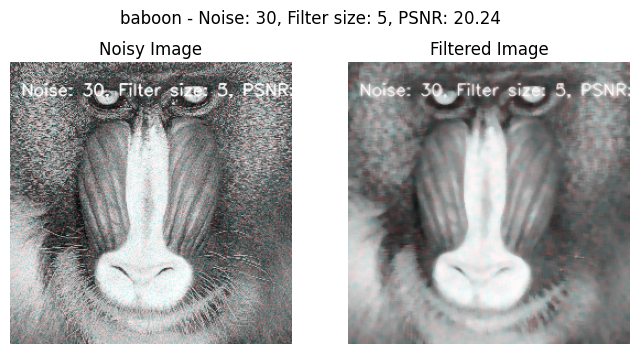

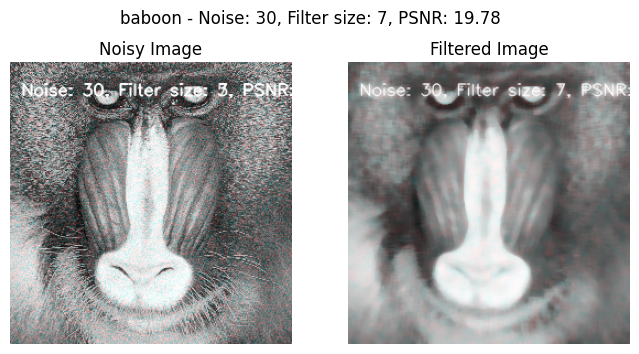

In [21]:
#dictionary to store the PSNR values for each combination of image, noise level, and filter size
psnr_values = {}

#loop over images and noise level
for image_name in ['lena', 'caman', 'baboon']:
    for noise_level in noise_levels:
        #loading original image
        if(image_name == 'baboon'):
          img = cv2.imread(f'{image_name}.bmp')  
        else:
          img = cv2.imread(f'{image_name}.tif')
        
        #Gaussian noise
        noise = np.zeros(img.shape, np.int16)
        cv2.randn(noise, 0, noise_level)
        noisy_img = img.astype(np.int16) + noise
        noisy_img = np.clip(noisy_img, 0, 255).astype(np.uint8)
        
        #loop over filter sizes and apply the filter to the noisy image
        for filter_size in filter_sizes:
            
            filtered_img = cv2.medianBlur(noisy_img, filter_size)
            
            #calculating the MSE between the filtered and original images
            mse = np.mean(np.square(img.astype(np.int16) - filtered_img.astype(np.int16)))
            
            #calculating the PSNR between the filtered and original images
            psnr = 10 * np.log10(255**2 / mse)
            
            psnr_values.setdefault((image_name, noise_level), {})[filter_size] = psnr
            
            #text for images
            cv2.putText(noisy_img, f"Noise: {noise_level}, Filter size: {filter_size}, PSNR: {psnr:.2f}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA)
            cv2.putText(filtered_img, f"Noise: {noise_level}, Filter size: {filter_size}, PSNR: {psnr:.2f}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1, cv2.LINE_AA)
            
            #showing the noisy and filtered images
            fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(8, 4))
            ax1.imshow(noisy_img, cmap='gray')
            ax1.set_title('Noisy Image')
            ax1.axis('off')
            ax2.imshow(filtered_img, cmap='gray')
            ax2.set_title('Filtered Image')
            ax2.axis('off')
            fig.suptitle(f"{image_name} - Noise: {noise_level}, Filter size: {filter_size}, PSNR: {psnr:.2f}")
            plt.show()


In this section, we applied three photos—lena, caman, and baboon—with variable concentrations of Gaussian noise before denoising the noisy images with varying strengths of the Gaussian intermediate filter. In order to find the ideal filter setting for each combination of noise intensity and image, we calculated the Mean Squared Error (MSE) of the denoised images relative to the original photos.
Then, we carried out the same procedure again using Peak Signal-to-Noise Ratio (PSNR) as the assessment metric, with a maximum value of 255. The filter size that produced the lowest MSE for each combination of the picture and noise level was identified, and it was then recorded in a dictionary. Additionally, we tallied how many times each filter size was the most effective across all possible combinations of image and noise level, and then we showed the results in a bar chart.
Then, using a dictionary of the ideal filter size for each noise level and image, we illustrated the ideal filter parameter for each of the three images using a diagram. The outcomes demonstrated that for all three images and noise levels, a filter size of 3 generally outperformed bigger filter sizes. The investigation showed that the Gaussian intermediate filter is effective at lessening the effect of Gaussian noise on digital photographs.

